<a href="https://colab.research.google.com/github/theraghav12/ML/blob/main/Fine_Tuned.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

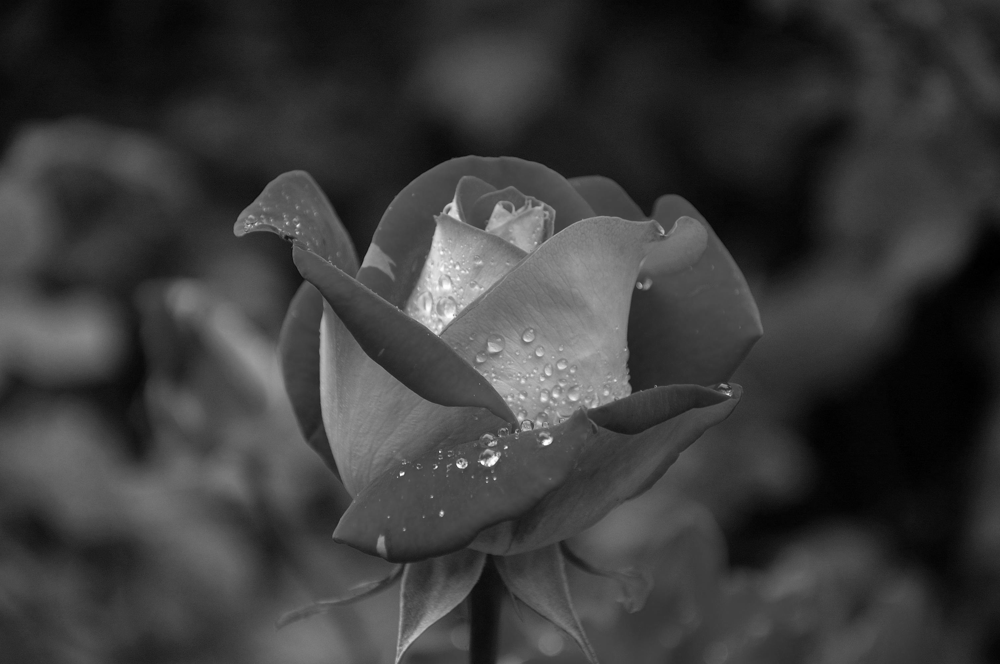

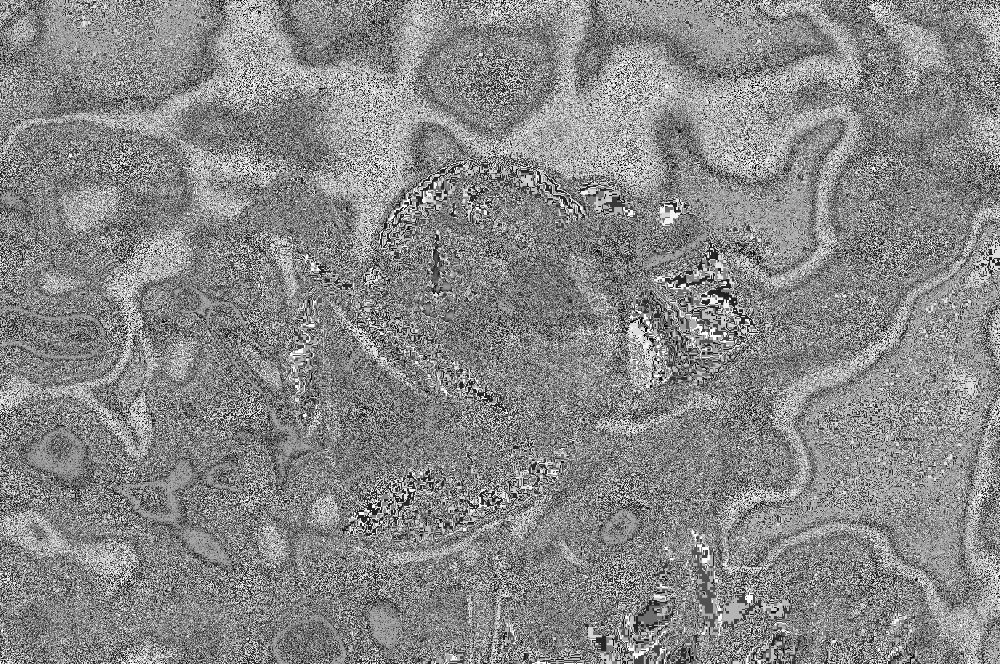

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

image = cv2.imread('/content/pexels-pixabay-56866.jpg')

gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

hist = cv2.calcHist([gray_image], [0], None, [256], [0, 256])

cdf = hist.cumsum()
cdf_normalized = cdf * hist.max() / cdf.max()

contrast_stretched_image = cv2.LUT(gray_image, cdf_normalized.astype('uint8'))


cv2.imwrite('/content/modified1.jpg', contrast_stretched_image)

cv2_imshow(gray_image)
cv2_imshow(contrast_stretched_image)


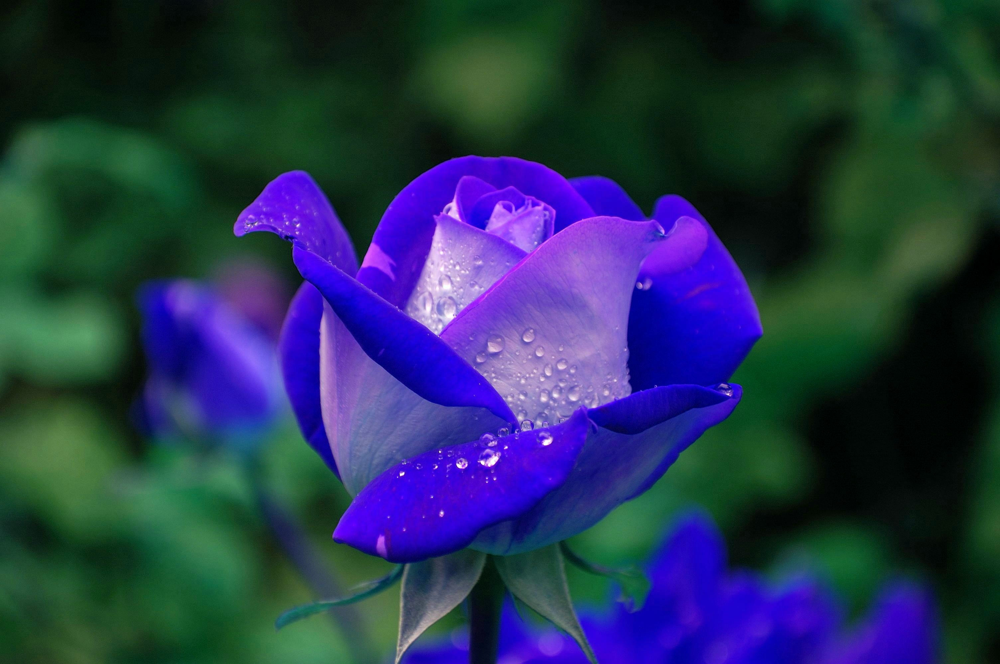

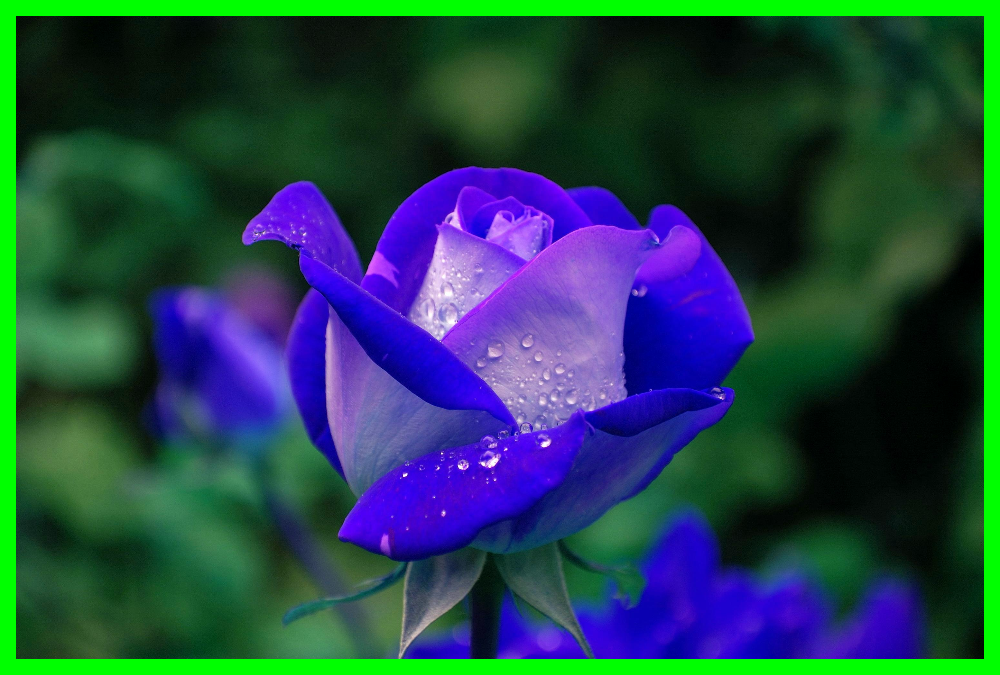

In [ ]:
import cv2
from google.colab.patches import cv2_imshow


image = cv2.imread('/content/pexels-pixabay-56866.jpg'
)

border_width = 50
border_color = (0, 255, 0)

image_with_border = cv2.copyMakeBorder(image, border_width, border_width, border_width, border_width,
                                        cv2.BORDER_CONSTANT, value=border_color)

cv2.imwrite('modified.jpg', image_with_border)


cv2_imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Display original image
cv2_imshow(cv2.cvtColor(image_with_border, cv2.COLOR_BGR2RGB))  # Display modified image




In [ ]:
import numpy as np
from keras.applications.vgg16 import VGG16, preprocess_input
from keras.preprocessing import image
from scipy.spatial.distance import cosine

In [ ]:
from keras.models import Model
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam

In [ ]:
base_model = VGG16(weights='imagenet', include_top=False)


In [ ]:
from keras.layers import Dropout

def fine_tune_model(base_model):
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout layer for regularization
    x = Dense(512, activation='relu')(x)
    x = Dropout(0.5)(x)  # Add dropout layer for regularization
    predictions = Dense(256, activation='relu')(x)  # Add another dense layer
    model = Model(inputs=base_model.input, outputs=predictions)
    for layer in base_model.layers:
        layer.trainable = False
    model.compile(optimizer=Adam(), loss='categorical_crossentropy')
    return model


In [ ]:
model = fine_tune_model(base_model)

In [ ]:
def extract_features(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_data = image.img_to_array(img)
    img_data = np.expand_dims(img_data, axis=0)
    img_data = preprocess_input(img_data)
    features = model.predict(img_data)
    return features.flatten()

In [ ]:
#border
modified_image_path = '/content/modified.jpg'
non_modified_image_path = '/content/pexels-pixabay-56866.jpg'


features_modified = extract_features(modified_image_path)
features_non_modified = extract_features(non_modified_image_path)


similarity = 1 - cosine(features_modified, features_non_modified)
print("Cosine Similarity between the images:", similarity)

1/1 [==============================] - 0s 28ms/step
Cosine Similarity between the images: 0.8992226123809814


In [ ]:
#colour change
modified_image_path = '/content/modified1.jpg'
non_modified_image_path = '/content/pexels-pixabay-56866.jpg'


features_modified = extract_features(modified_image_path)
features_non_modified = extract_features(non_modified_image_path)


similarity = 1 - cosine(features_modified, features_non_modified)
print("Cosine Similarity between the images:", similarity)

1/1 [==============================] - 0s 44ms/step
Cosine Similarity between the images: 0.5252389907836914


In [ ]:
#above code is implemented by Raghav Khurana(22148)